In [2]:
import pandas as pd 
import numpy as np 
import seaborn as sns 
import matplotlib.pyplot as plt 
from sklearn.preprocessing import StandardScaler, normalize
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA

In [3]:
creditcard_df = pd.read_csv('Marketing_data.csv')
creditcard_df.head()

,CUST_ID,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
0,C10001,40.900749,0.818182,95.40,0.00,95.4,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.0,201.802084,139.509787,0.000000,12
1,C10002,3202.467416,0.909091,0.00,0.00,0.0,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.0,4103.032597,1072.340217,0.222222,12
2,C10003,2495.148862,1.000000,773.17,773.17,0.0,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.0,622.066742,627.284787,0.000000,12
3,C10004,1666.670542,0.636364,1499.00,1499.00,0.0,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.0,0.000000,NaN,0.000000,12
4,C10005,817.714335,1.000000,16.00,16.00,0.0,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.0,678.334763,244.791237,0.000000,12


<AxesSubplot:>

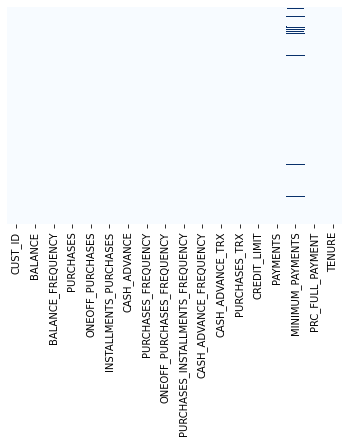

In [4]:
sns.heatmap(creditcard_df.isnull(), yticklabels=False, cbar=False, cmap='Blues')

In [5]:
creditcard_df.isnull().sum()

CUST_ID                               0
BALANCE                               0
BALANCE_FREQUENCY                     0
PURCHASES                             0
ONEOFF_PURCHASES                      0
INSTALLMENTS_PURCHASES                0
CASH_ADVANCE                          0
PURCHASES_FREQUENCY                   0
ONEOFF_PURCHASES_FREQUENCY            0
PURCHASES_INSTALLMENTS_FREQUENCY      0
CASH_ADVANCE_FREQUENCY                0
CASH_ADVANCE_TRX                      0
PURCHASES_TRX                         0
CREDIT_LIMIT                          1
PAYMENTS                              0
MINIMUM_PAYMENTS                    313
PRC_FULL_PAYMENT                      0
TENURE                                0
dtype: int64

In [6]:
creditcard_df.loc[(creditcard_df.MINIMUM_PAYMENTS.isnull()==True),'MINIMUM_PAYMENTS'] = creditcard_df.MINIMUM_PAYMENTS.mean()

In [7]:
creditcard_df.loc[(creditcard_df.CREDIT_LIMIT.isnull()==True),'CREDIT_LIMIT'] = creditcard_df.CREDIT_LIMIT.mean()

In [8]:
creditcard_df.duplicated().sum()

0

In [9]:
creditcard_df.drop('CUST_ID', axis=1, inplace=True)

In [10]:
n = len(creditcard_df.columns)

In [11]:
n

17

In [12]:
creditcard_df.columns

Index(['BALANCE', 'BALANCE_FREQUENCY', 'PURCHASES', 'ONEOFF_PURCHASES',
       'INSTALLMENTS_PURCHASES', 'CASH_ADVANCE', 'PURCHASES_FREQUENCY',
       'ONEOFF_PURCHASES_FREQUENCY', 'PURCHASES_INSTALLMENTS_FREQUENCY',
       'CASH_ADVANCE_FREQUENCY', 'CASH_ADVANCE_TRX', 'PURCHASES_TRX',
       'CREDIT_LIMIT', 'PAYMENTS', 'MINIMUM_PAYMENTS', 'PRC_FULL_PAYMENT',
       'TENURE'],
      dtype='object')

C:\Users\kashindra\anaconda3\lib\site-packages\seaborn\distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
C:\Users\kashindra\anaconda3\lib\site-packages\seaborn\distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
C:\Users\kashindra\anaconda3\lib\site-packages\seaborn\distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` 

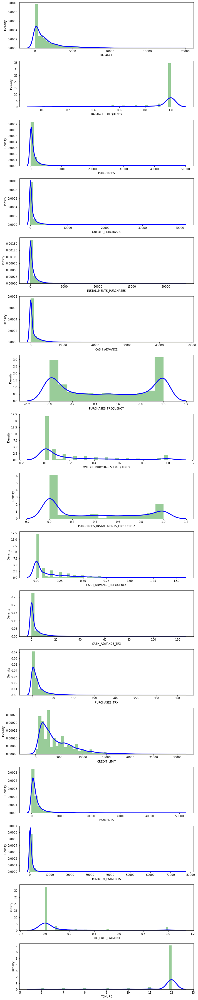

In [13]:
plt.figure(figsize=(10,50))
for i in range(len(creditcard_df.columns)):
    plt.subplot(17, 1, i+1)
    sns.distplot(creditcard_df[creditcard_df.columns[i]], kde_kws={'color':'b', 'lw':3, 'label':'kwe'}, hist_kws={'color':'g'})
    
plt.tight_layout()

In [14]:
correlations = creditcard_df.corr()

<AxesSubplot:>

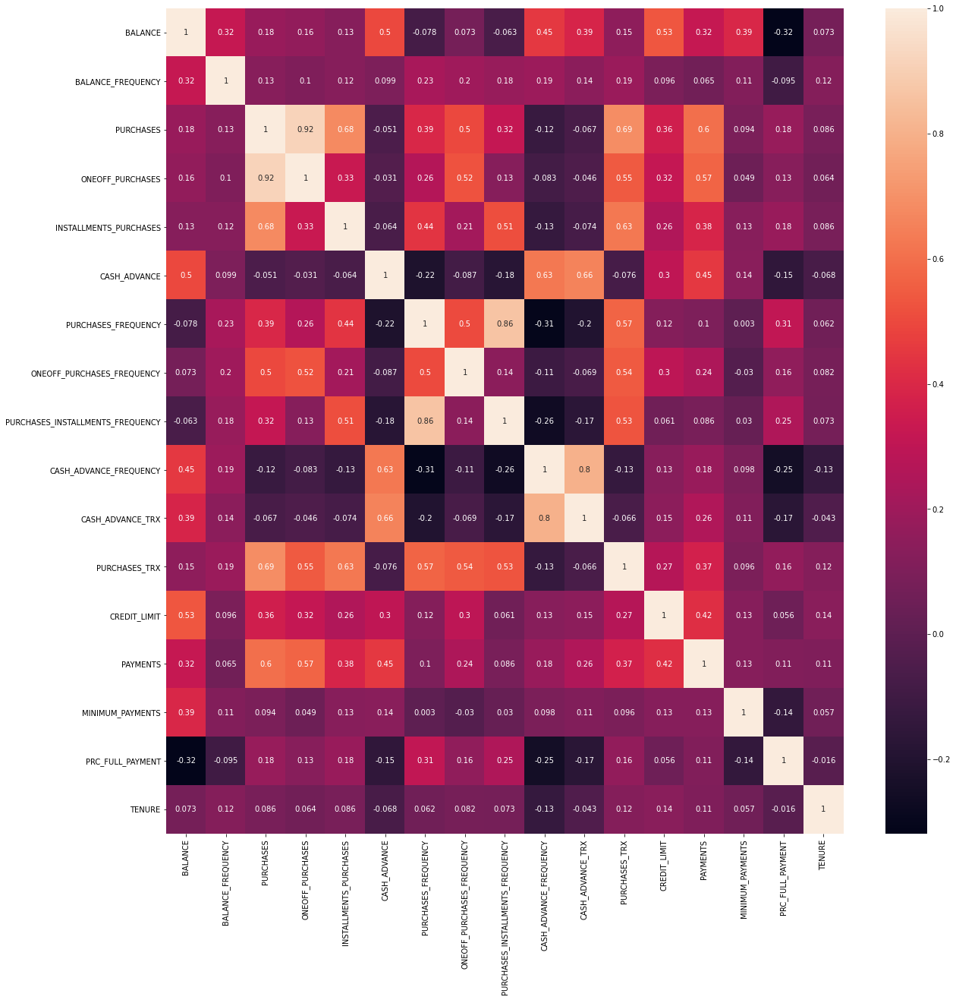

In [15]:
f, ax = plt.subplots(figsize=(20, 20))
sns.heatmap(correlations, annot=True)


In [39]:
scaler = StandardScaler()
creditcard_df_scaled = scaler.fit_transform(creditcard_df)

In [40]:
creditcard_df_scaled.shape

(8950, 17)

In [41]:
creditcard_df_scaled

array([[-0.73198937, -0.24943448, -0.42489974, ..., -0.31096755,
        -0.52555097,  0.36067954],
       [ 0.78696085,  0.13432467, -0.46955188, ...,  0.08931021,
         0.2342269 ,  0.36067954],
       [ 0.44713513,  0.51808382, -0.10766823, ..., -0.10166318,
        -0.52555097,  0.36067954],
       ...,
       [-0.7403981 , -0.18547673, -0.40196519, ..., -0.33546549,
         0.32919999, -4.12276757],
       [-0.74517423, -0.18547673, -0.46955188, ..., -0.34690648,
         0.32919999, -4.12276757],
       [-0.57257511, -0.88903307,  0.04214581, ..., -0.33294642,
        -0.52555097, -4.12276757]])

In [42]:
score_1 = []

range_values = range(1,20)

for i in range_values:
    kmeans = KMeans(n_clusters=i)
    kmeans.fit(creditcard_df_scaled)
    score_1.append(kmeans.inertia_)



In [43]:
score_1

[152149.99999999878,
 127785.30715835438,
 111986.72270896174,
 99073.93763633838,
 91503.39081843321,
 84852.59400226283,
 79532.40973829066,
 75113.50123626005,
 69971.21669563373,
 66488.84303967345,
 63633.201489829815,
 61370.761108283834,
 59181.96287794839,
 57489.55226995426,
 55894.10505430711,
 54576.24338710092,
 53197.2490435929,
 52042.91394358071,
 50707.825102931194]

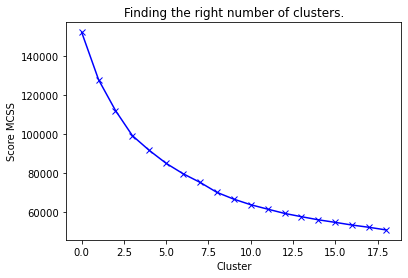

In [44]:
plt.plot(score_1, 'bx-')
plt.title('Finding the right number of clusters.')
plt.xlabel('Cluster')
plt.ylabel('Score MCSS')
plt.show()

In [45]:
kmeans = KMeans(8)
kmeans.fit(creditcard_df_scaled)
labels = kmeans.labels_

In [46]:
labels

array([2, 0, 5, ..., 1, 1, 1])

In [47]:
kmeans.cluster_centers_.shape

(8, 17)

In [48]:
kmeans.cluster_centers_

array([[ 1.64696503e+00,  3.92410774e-01, -2.03099222e-01,
        -1.48305442e-01, -2.07846633e-01,  2.00802977e+00,
        -4.56847026e-01, -1.87387496e-01, -4.05076905e-01,
         1.93610644e+00,  1.94343046e+00, -2.37678400e-01,
         1.01107078e+00,  8.42604212e-01,  3.87712207e-01,
        -3.88351693e-01,  6.82073156e-02],
       [-3.35505569e-01, -3.48075760e-01, -2.84525485e-01,
        -2.08972655e-01, -2.88475165e-01,  6.55386827e-02,
        -1.98734630e-01, -2.72572459e-01, -2.30754878e-01,
         3.04112279e-01, -2.21599280e-03, -3.85586411e-01,
        -5.56898058e-01, -3.90700534e-01, -2.09383182e-01,
         1.28987659e-02, -3.19376501e+00],
       [ 6.38488714e-03,  4.01993618e-01, -3.43303933e-01,
        -2.24474851e-01, -3.99228349e-01, -1.04779622e-01,
        -8.08748876e-01, -3.34111718e-01, -7.52433769e-01,
         8.29773650e-02, -4.23110797e-02, -4.64536459e-01,
        -3.01035777e-01, -2.48324658e-01, -4.65847032e-02,
        -4.52285323e-01,  2.7

In [49]:
cluster_centers = pd.DataFrame(data=kmeans.cluster_centers_, columns=[creditcard_df.columns])

In [50]:
cluster_centers

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
0,1.646965,0.392411,-0.203099,-0.148305,-0.207847,2.008030,-0.456847,-0.187387,-0.405077,1.936106,1.943430,-0.237678,1.011071,0.842604,0.387712,-0.388352,0.068207
1,-0.335506,-0.348076,-0.284525,-0.208973,-0.288475,0.065539,-0.198735,-0.272572,-0.230755,0.304112,-0.002216,-0.385586,-0.556898,-0.390701,-0.209383,0.012899,-3.193765
2,0.006385,0.401994,-0.343304,-0.224475,-0.399228,-0.104780,-0.808749,-0.334112,-0.752434,0.082977,-0.042311,-0.464536,-0.301036,-0.248325,-0.046585,-0.452285,0.271465
3,-0.380758,0.329554,-0.042345,-0.233494,0.328680,-0.368444,0.978918,-0.353868,1.169470,-0.478072,-0.362956,0.166158,-0.277981,-0.225680,-0.096593,0.314865,0.251722
4,1.374491,0.412070,7.177493,6.384202,5.239545,0.016050,1.082454,1.917512,1.031769,-0.290144,-0.107898,4.786628,2.181050,4.962364,0.709040,0.864673,0.332658
5,0.144853,0.430379,0.949157,0.899290,0.592092,-0.306067,1.095259,1.866662,0.543105,-0.405219,-0.316066,1.205308,0.708918,0.398743,-0.046600,0.452477,0.307850
6,-0.701894,-2.135494,-0.307095,-0.230581,-0.302387,-0.322957,-0.547410,-0.428870,-0.441051,-0.522120,-0.376732,-0.416657,-0.172121,-0.201648,-0.257506,0.295702,0.201907
7,1.299171,0.455853,-0.051371,-0.271244,0.376157,-0.010364,-0.011158,-0.532469,0.230336,-0.241518,-0.060225,0.197608,0.006354,-0.092120,11.484621,-0.525551,0.300092


In [51]:
cluster_centers = scaler.inverse_transform(cluster_centers)
cluster_centers = pd.DataFrame(data=cluster_centers, columns=[creditcard_df.columns])
cluster_centers

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
0,4992.493509,0.970229,569.280215,346.280713,223.114514,5189.803349,0.306996,0.146556,0.203449,0.522579,16.511312,8.802036,8173.138626,4172.400485,1767.753487,4.012844e-02,11.608597
1,866.148306,0.794815,395.311749,245.585564,150.203132,1116.308792,0.410589,0.121144,0.272729,0.196000,3.233704,5.125596,2468.226470,602.104087,376.247870,1.574873e-01,7.243243
2,1577.764431,0.972499,269.730689,219.855094,50.050403,759.143350,0.165761,0.102786,0.065401,0.151749,2.960085,3.163193,3399.158130,1014.268300,755.642857,2.142895e-02,11.880608
3,771.958570,0.955339,912.733389,204.884980,708.288448,206.227034,0.883238,0.096892,0.829214,0.039477,0.771921,18.839901,3483.039508,1079.822142,639.099492,2.458072e-01,11.854187
4,4425.362379,0.974886,16338.028250,11188.905375,5149.122875,1012.529590,0.924792,0.774489,0.774489,0.077083,2.512500,133.687500,12430.000000,16098.700812,2516.595215,4.066166e-01,11.962500
5,1865.974028,0.979224,3031.092592,2085.074839,946.489081,337.033968,0.929931,0.759319,0.580281,0.054056,1.091909,44.669285,7073.784189,2887.466123,755.606598,2.860563e-01,11.929301
6,103.540821,0.371392,347.092201,209.719739,137.622715,301.615215,0.270648,0.074517,0.189152,0.030663,0.677909,4.353288,3868.203579,1149.392761,264.100759,2.402024e-01,11.787521
7,4268.589649,0.985258,893.449189,142.227297,751.221892,957.138029,0.485872,0.043612,0.455979,0.086814,2.837838,19.621622,4517.567568,1466.465369,27628.631071,5.551115e-17,11.918919


In [52]:
creditcard_df_cluster = pd.concat([creditcard_df, pd.DataFrame({'cluster':labels})], axis=1)

In [53]:
creditcard_df_cluster.head()

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,cluster
0,40.900749,0.818182,95.40,0.00,95.4,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.0,201.802084,139.509787,0.000000,12,2
1,3202.467416,0.909091,0.00,0.00,0.0,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.0,4103.032597,1072.340217,0.222222,12,0
2,2495.148862,1.000000,773.17,773.17,0.0,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.0,622.066742,627.284787,0.000000,12,5
3,1666.670542,0.636364,1499.00,1499.00,0.0,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.0,0.000000,864.206542,0.000000,12,2
4,817.714335,1.000000,16.00,16.00,0.0,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.0,678.334763,244.791237,0.000000,12,2


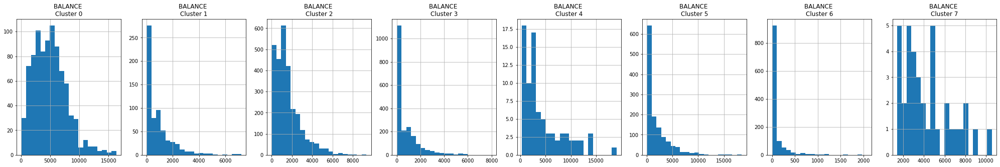

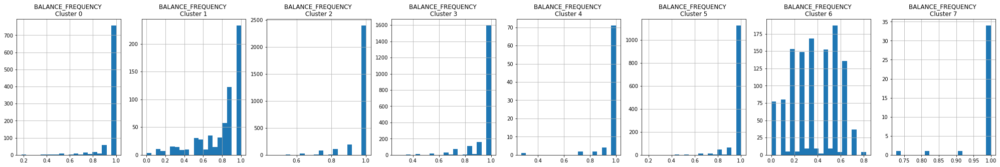

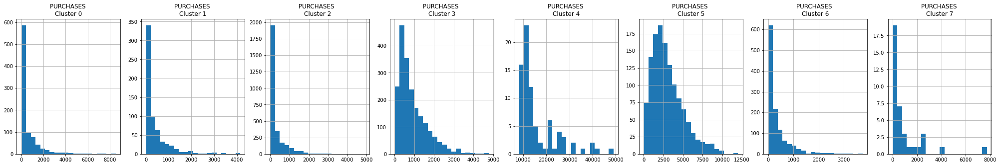

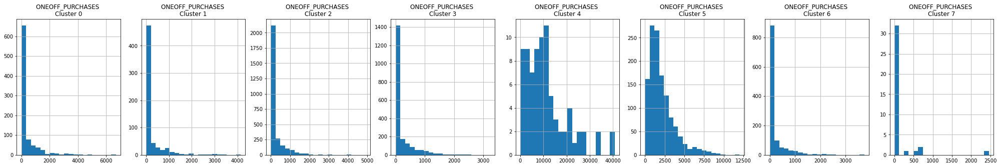

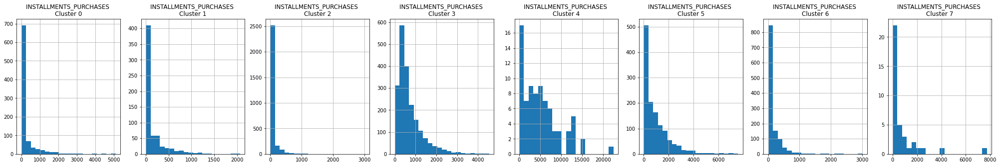

...

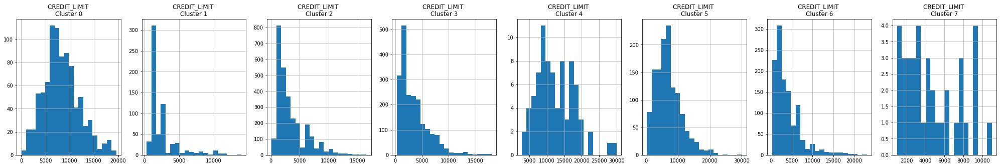

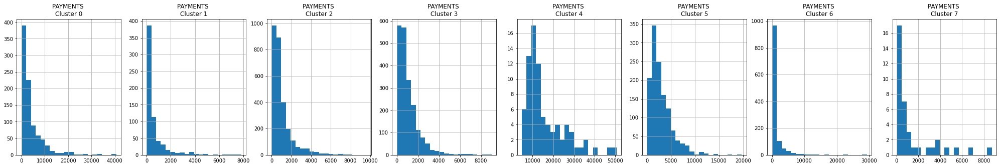

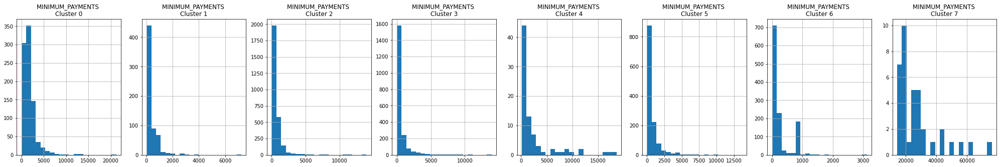

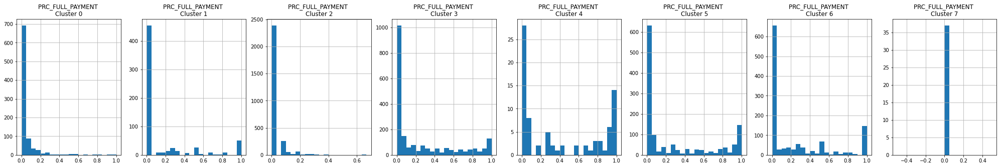

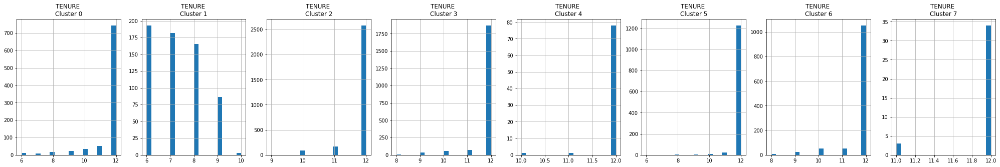

In [54]:
for i in creditcard_df.columns:
    plt.figure(figsize=(35,5))
    for j in range(8):
        plt.subplot(1,8,j+1)
        cluster = creditcard_df_cluster[creditcard_df_cluster.cluster == j]
        cluster[i].hist(bins=20)
        plt.title("{} \nCluster {}".format(i,j))
plt.show()